# EDA of Single Family Loan-Level Data for the year 2007, 2008 and 2009

**Importing dependencies**

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import seaborn as sns
import cufflinks as cf
import plotly.graph_objs as go
import plotly.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from datetime import datetime as dt
import calendar as cal

init_notebook_mode(connected=True)
cf.go_offline()

from IPython.core.display import HTML
%matplotlib inline

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


**Load the sample data after web scrapping into dataframes**

In [2]:
df = pd.read_csv('Sample Origination Combined.csv', low_memory=False)
pf = pd.read_csv('Sample Performance Combined Summary.csv', low_memory=False)

In [3]:
df.count()

fico              637500
dt_first_pi       637500
flag_fthb         637500
dt_matr           637500
cd_msa            637500
mi_pct            637500
cnt_units         637500
occpy_sts         637500
cltv              637500
dti               637500
orig_upb          637500
ltv               637500
int_rt            637500
channel           637500
ppmt_pnlty        637500
prod_type         637500
st                637500
prop_type         637500
zipcode           637500
id_loan           637500
loan_purpose      637500
orig_loan_term    637500
cnt_borr          637500
seller_name       637500
servicer_name     637500
flag_sc           637500
Year              637500
dtype: int64

In [4]:
pf.count()

loan_seq                 637441
max_current_upb          637441
min_current_upb          637441
max_delq_sts             637441
min_delq_sts             637441
max_cd_zero_bal          637441
min_cd_zero_bal          637441
max_non_mi_recoveries    637441
min_non_mi_recoveries    637441
max_expenses             637441
min_expenses             637441
max_legal_costs          637441
min_legal_costs          637441
max_maint_pres_costs     637441
min_maint_pres_costs     637441
max_taxes_ins_costs      637441
min_taxes_ins_costs      637441
max_misc_costs           637441
min_misc_costs           637441
max_actual_loss          637441
min_actual_loss          637441
max_modcost              637441
min_modcost              637441
dtype: int64

In [5]:
df.head(3).transpose()

,0,1,2
fico,722,759,591
dt_first_pi,200504,200503,200504
flag_fthb,N,N,N
dt_matr,203503,203502,203503
cd_msa,0,0,39100
mi_pct,0,0,0
cnt_units,1,1,1
occpy_sts,P,P,P
cltv,80,25,48
dti,48,25,34


In [6]:
pf.head(3).transpose()

,0,1,2
loan_seq,F105Q1000064,F105Q1000076,F105Q1000087
max_current_upb,62000,197000,100000
min_current_upb,0,0,0
max_delq_sts,0,0,1
min_delq_sts,0,0,0
max_cd_zero_bal,1,1,1
min_cd_zero_bal,-1,-1,-1
max_non_mi_recoveries,0,0,0
min_non_mi_recoveries,0,0,0
max_expenses,0,0,0


**Merging the two datasets**

In [7]:
joined_df = pd.DataFrame()
joined_df = pd.merge(df, pf, left_on = 'id_loan',right_on='loan_seq',how='inner')
joined_df

,fico,dt_first_pi,flag_fthb,dt_matr,cd_msa,mi_pct,cnt_units,occpy_sts,cltv,dti,...,max_maint_pres_costs,min_maint_pres_costs,max_taxes_ins_costs,min_taxes_ins_costs,max_misc_costs,min_misc_costs,max_actual_loss,min_actual_loss,max_modcost,min_modcost
0,722,200504,N,203503,0,0,1,P,80,48,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
1,759,200503,N,203502,0,0,1,P,25,25,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2,591,200504,N,203503,39100,0,1,P,48,34,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
3,792,200503,N,203502,39100,0,1,P,90,33,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
4,725,200503,N,203502,48864,0,1,P,49,41,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
5,788,200503,N,203502,0,0,1,P,75,55,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
6,691,200503,N,203502,0,35,1,P,97,48,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3508.939941,0.0
7,687,200503,N,203502,0,0,1,P,40,46,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
8,784,200503,N,203502,0,0,1,P,35,30,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
9,703,200503,N,203502,0,0,1,P,67,53,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0


In [8]:
joined_df.count()

fico                     637441
dt_first_pi              637441
flag_fthb                637441
dt_matr                  637441
cd_msa                   637441
mi_pct                   637441
cnt_units                637441
occpy_sts                637441
cltv                     637441
dti                      637441
orig_upb                 637441
ltv                      637441
int_rt                   637441
channel                  637441
ppmt_pnlty               637441
prod_type                637441
st                       637441
prop_type                637441
zipcode                  637441
id_loan                  637441
loan_purpose             637441
orig_loan_term           637441
cnt_borr                 637441
seller_name              637441
servicer_name            637441
flag_sc                  637441
Year                     637441
loan_seq                 637441
max_current_upb          637441
min_current_upb          637441
max_delq_sts             637441
min_delq

**Summary Statistics By Year**

In [108]:
joined_df.groupby(['Year']).count()['id_loan'].iplot(
    yTitle='Loan Count',
    xTitle='Year',
    title='Year Wise Loan Count',
    colors='Red',
    mode='lines+markers')

The number of loans are almost same throughout from 2005 to 2006 except 2017

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



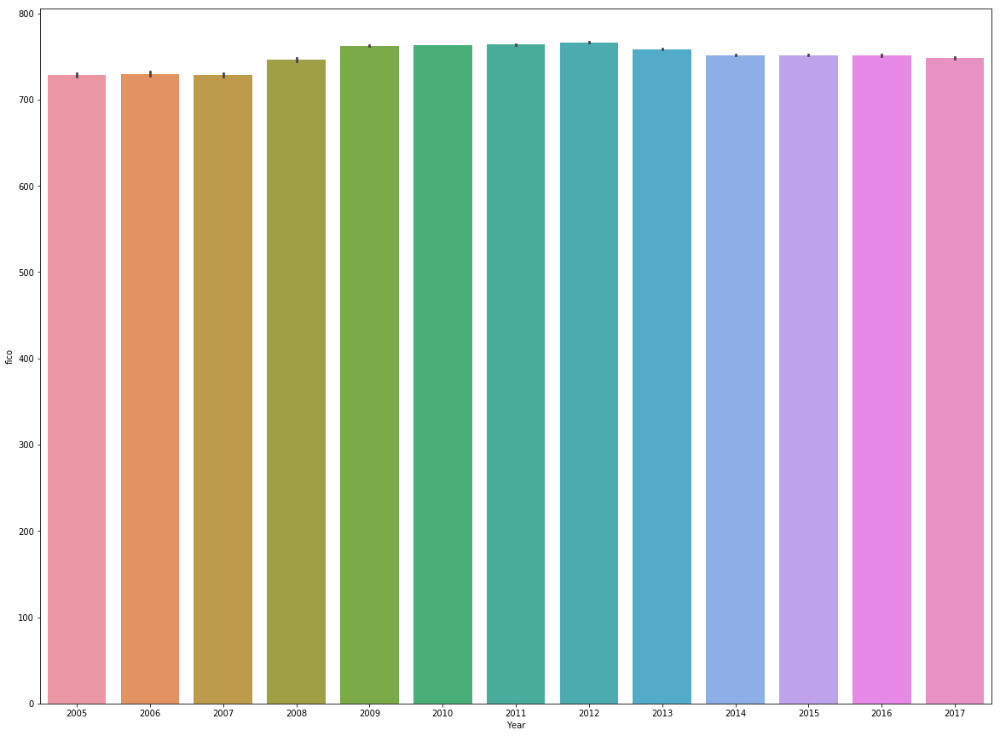

In [10]:
plt.figure(figsize=(20,15))
sns.barplot('Year','fico', data=joined_df)

The mean credit score looks constant, lets take a look at the below plot for more detail

In [109]:
joined_df[joined_df['fico'] != 9999].groupby(['Year']).mean()['fico'].iplot(
    yTitle='Credit Score',
    xTitle='Year',
    title='Year Wise Mean Credit Score',
    colors='Red',
    mode='lines+markers')

The mean credit score seems to be in the range of 722 and 766, with highest for the year 2012. It becomes almost constant after 2014 and is the least for year 2006.

In [110]:
joined_df[joined_df['fico'] != 9999].groupby(['Year']).max()['fico'].iplot(
    yTitle='Credit Score',
    xTitle='Year',
    title='Year Wise Maximum Credit Score',
    colors='Red',
    mode='lines+markers')

The highest credit score was recorded to be 850 although the mean was the lowest for the year 2006 and it is constant across 2012 to 2015

In [111]:
joined_df[joined_df['max_delq_sts'] != 'R'].groupby(['Year']).count()['max_delq_sts'].iplot(
    yTitle='Max Deliquency',
    xTitle='Year',
    title='Year Wise Max Deliquency Count',
    colors='Red',
    mode='lines+markers')

2017 shows less counts for the deliquency which is obvious as we have less loan counts in that year. Other wise it is constant thoughout except 2006 and 2007.

In [196]:
joined_df[(joined_df['max_delq_sts'] != 'R') & ((joined_df['fico'] != 9999))].groupby(['Year']).max()[['max_delq_sts','fico']].iplot(
    yTitle='Credit Score Vs Max Deliquency',
    xTitle='Year',
    title='Year Wise Credit Score Vs Max Deliquency Max Value',
    mode='lines+markers')

The ma credit score is constant as before however the maximum deliquency is 99 for the years 2005 to 2008. No deliquency status present for the year 2012

In [114]:
joined_df[(joined_df['max_delq_sts'] != 'R') & ((joined_df['fico'] != 9999))].groupby(['Year']).count()[['max_delq_sts','fico']].iplot(
   yTitle='Credit Score Vs Max Deliquency',
    xTitle='Year',
    title='Year Wise Credit Score Vs Max Deliquency Count',
    mode='lines+markers')

Here, we can see the count of maximum deliquency is present for year 2012, which we assume has to be 0 compared to previous plot.

In [118]:
joined_df.groupby(['Year']).mean()['orig_upb'].iplot(
    yTitle='Original UPB',
    xTitle='Year',
    title='Year Wise Mean Original UPB',
    colors='Red',
    mode='lines+markers')

The mean Unpaid principal balance increseas with respect to years

In [194]:
joined_df.groupby(['Year']).mean()['max_current_upb'].iplot(
    yTitle='Max Current UPB',
    xTitle='Year',
    title='Year Wise Mean of Max Current UPB',
    colors='Red',
    mode='lines+markers')

In [119]:
joined_df.groupby(['Year']).mean()[['orig_upb','min_current_upb']].iplot(
    yTitle='Original UPB VS Min Current UPB',
    xTitle='Year',
    title='Year Wise Original UPB VS Min Current UPB',
    mode='lines+markers')

The difference between mean Unpaid principal balance and the minimum current upb increases as we close down to 2017

In [120]:
joined_df.groupby(['Year']).mean()[['max_current_upb','min_current_upb']].iplot(
    yTitle='Max Current UPB VS Min Current UPB',
    xTitle='Year',
    title='Year Wise Max Current UPB VS Min Current UPB',
    mode='lines+markers')

The same goes for the minimum and maximum current Unpaid principal balance

In [122]:
joined_df.groupby(['Year']).mean()['int_rt'].iplot(
    yTitle='Interest Rate',
    xTitle='Year',
    title='Year Wise Interest Rate Mean',
    mode='lines+markers')

The mean interest rate decreases as we go towards 2012, later it goes up and down.

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



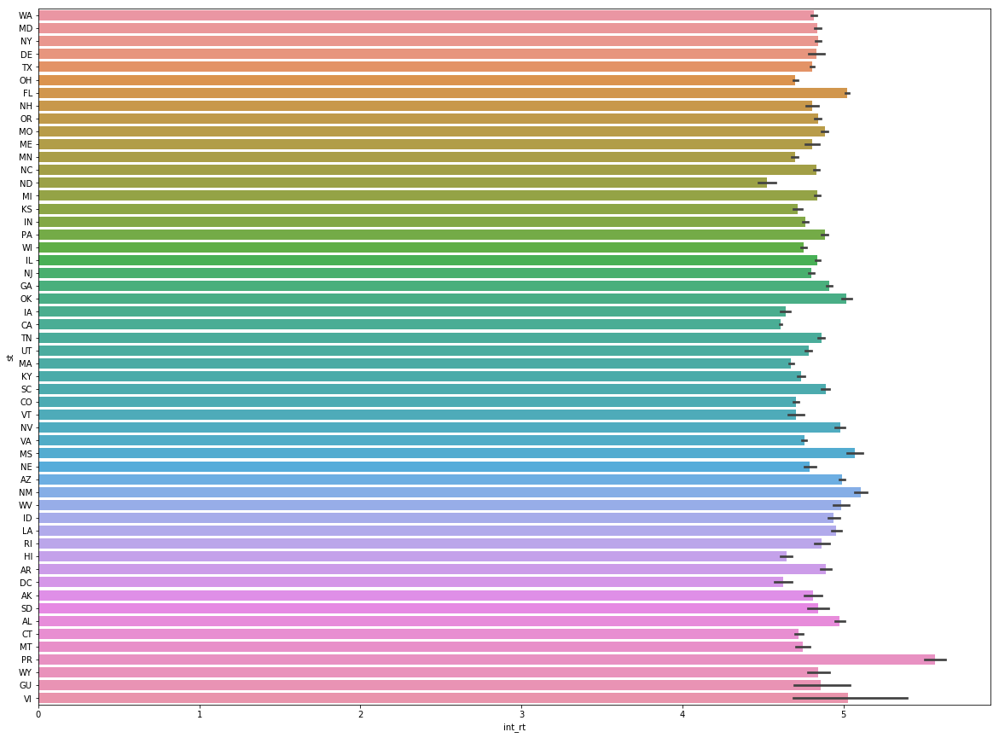

In [26]:
plt.figure(figsize=(20,15)) 
sns.barplot(x='int_rt', y='st',data= joined_df)

The mean intrest rate is highest for the state Puerto Rico, and lowest for North Dakota

In [123]:
joined_df.groupby(['st']).mean()['int_rt'].iplot(
    yTitle='Interest Rate',
    xTitle='State',
    title='State Wise Mean Interest Rate',
    mode='lines+markers')

A better representation of the mean interest rate across the states

In [127]:
joined_df.groupby(['st']).mean()['fico'].iplot(
    yTitle='Credit Score',
    xTitle='State',
    title='State Wise Mean Credit Score',
    mode='lines+markers')

Lowest Mean Credit Score justifies the high interest rate compared to previous plot for the state of PR.

In [239]:
joined_df.groupby(['Year']).mean()[['cltv','ltv']].iplot(
    yTitle='Combined LTV VS LTV',
    xTitle='Year',
    title='Year Wise Combined Loan To Value VS Loan To Value Analysis',
    mode='lines+markers')

The combined Loan to Value ratio is always greater than LTV acroos all years

In [189]:
joined_df.groupby(['Year']).mean()[['cltv','ltv','dti']].iplot(
    yTitle='Combined LTV VS LTV',
    xTitle='Year',
    title='Year Wise Combined Loan To Value VS Loan To Value Anaysis',
    mode='lines+markers')

The mean Debt to income ratio decreases with time 

**Creating a dataframe for the year 2007, 2008 and 2009**

In [28]:
df_2007 = joined_df[(joined_df['Year'] == 2007)]
df_2008 = joined_df[(joined_df['Year'] == 2008)]
df_2009 = joined_df[(joined_df['Year'] == 2009)]

df_789 = pd.concat([df_2007,df_2008,df_2009])

In [29]:
df_789['Year'].unique()

array([2007, 2008, 2009], dtype=int64)

In [30]:
df_789.count()

fico                     149989
dt_first_pi              149989
flag_fthb                149989
dt_matr                  149989
cd_msa                   149989
mi_pct                   149989
cnt_units                149989
occpy_sts                149989
cltv                     149989
dti                      149989
orig_upb                 149989
ltv                      149989
int_rt                   149989
channel                  149989
ppmt_pnlty               149989
prod_type                149989
st                       149989
prop_type                149989
zipcode                  149989
id_loan                  149989
loan_purpose             149989
orig_loan_term           149989
cnt_borr                 149989
seller_name              149989
servicer_name            149989
flag_sc                  149989
Year                     149989
loan_seq                 149989
max_current_upb          149989
min_current_upb          149989
max_delq_sts             149989
min_delq

In [31]:
df_789.describe()

,fico,dt_first_pi,dt_matr,cd_msa,mi_pct,cnt_units,cltv,dti,orig_upb,ltv,...,max_maint_pres_costs,min_maint_pres_costs,max_taxes_ins_costs,min_taxes_ins_costs,max_misc_costs,min_misc_costs,max_actual_loss,min_actual_loss,max_modcost,min_modcost
count,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.00000,...,149989.0,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000,149989.000000
mean,745.722213,200823.406843,203577.916434,25338.928481,3.670456,1.029776,70.965384,51.003967,200487.649094,69.27844,...,0.0,-222.963591,7.831988,-331.521858,9.701498,-37.976472,11.357346,-3781.657295,951.758840,-0.006494
std,190.998274,88.912735,536.570723,15160.903319,9.109469,0.224731,18.281725,123.962432,109541.055539,17.89644,...,0.0,1852.843573,869.698337,2676.306646,1650.429217,644.799795,569.070557,22683.279007,7435.064879,2.496506
min,333.000000,200501.000000,201208.000000,0.000000,0.000000,1.000000,6.000000,1.000000,10000.000000,6.00000,...,0.0,-60491.000000,0.000000,-182003.000000,0.000000,-142559.000000,0.000000,-528099.000000,0.000000,-966.830017
25%,707.000000,200712.000000,203705.000000,14484.000000,0.000000,1.000000,60.000000,26.000000,116000.000000,59.00000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,754.000000,200809.000000,203803.000000,26900.000000,0.000000,1.000000,75.000000,35.000000,176000.000000,75.00000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,785.000000,200906.000000,203902.000000,38300.000000,0.000000,1.000000,80.000000,44.000000,266000.000000,80.00000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,9999.000000,201508.000000,205403.000000,49740.000000,40.000000,4.000000,999.000000,999.000000,802000.000000,999.00000,...,0.0,0.000000,258903.000000,0.000000,527437.000000,0.000000,112666.000000,0.000000,230696.109375,0.000000


In [32]:
df_789.corr()

,fico,dt_first_pi,dt_matr,cd_msa,mi_pct,cnt_units,cltv,dti,orig_upb,ltv,...,max_maint_pres_costs,min_maint_pres_costs,max_taxes_ins_costs,min_taxes_ins_costs,max_misc_costs,min_misc_costs,max_actual_loss,min_actual_loss,max_modcost,min_modcost
fico,1.000000,0.069258,-0.007235,0.014019,-0.045881,-0.008056,-0.048686,-0.010480,0.024347,-0.049810,...,NaN,0.032208,-0.000562,0.035444,-0.001726,0.015253,-0.006939,0.042265,-0.039593,0.000645
dt_first_pi,0.069258,1.000000,0.031259,0.028031,-0.150643,-0.033345,-0.160718,-0.083022,0.114280,-0.137554,...,NaN,0.083822,-0.007077,0.083753,-0.000684,0.043082,-0.012261,0.124991,-0.091375,-0.002553
dt_matr,-0.007235,0.031259,1.000000,0.058014,0.118180,0.011869,0.226942,0.017478,0.188634,0.224367,...,NaN,-0.032915,0.001118,-0.034938,-0.000177,-0.011715,0.000979,-0.046053,0.034153,0.005613
cd_msa,0.014019,0.028031,0.058014,1.000000,-0.045218,-0.028904,-0.048774,0.008002,0.166227,-0.057262,...,NaN,0.001693,-0.000016,-0.003228,-0.005540,0.004667,-0.000291,-0.014390,0.027180,0.000129
mi_pct,-0.045881,-0.150643,0.118180,-0.045218,1.000000,-0.027325,0.470629,0.001126,-0.047077,0.518106,...,NaN,-0.085448,-0.001145,-0.079767,-0.000052,-0.029507,0.011529,-0.053341,0.062126,0.001048
cnt_units,-0.008056,-0.033345,0.011869,-0.028904,-0.027325,1.000000,-0.027210,0.036316,0.051395,-0.019524,...,NaN,-0.002679,0.008730,-0.027978,0.002105,-0.004967,-0.002593,-0.032194,0.025819,0.000345
cltv,-0.048686,-0.160718,0.226942,-0.048774,0.470629,-0.027210,1.000000,0.000144,0.094338,0.953310,...,NaN,-0.077577,-0.000054,-0.076587,0.001778,-0.032210,0.009397,-0.096900,0.067330,-0.001269
dti,-0.010480,-0.083022,0.017478,0.008002,0.001126,0.036316,0.000144,1.000000,0.017405,0.003941,...,NaN,-0.016489,0.014564,-0.017641,-0.000562,-0.003381,-0.000979,-0.019745,0.021307,0.000646
orig_upb,0.024347,0.114280,0.188634,0.166227,-0.047077,0.051395,0.094338,0.017405,1.000000,0.061120,...,NaN,0.005009,0.001833,-0.041966,0.007217,0.000308,0.003728,-0.042677,0.089597,0.000946
ltv,-0.049810,-0.137554,0.224367,-0.057262,0.518106,-0.019524,0.953310,0.003941,0.061120,1.000000,...,NaN,-0.079142,0.000674,-0.076129,0.002224,-0.033175,0.009778,-0.094310,0.070286,-0.001541


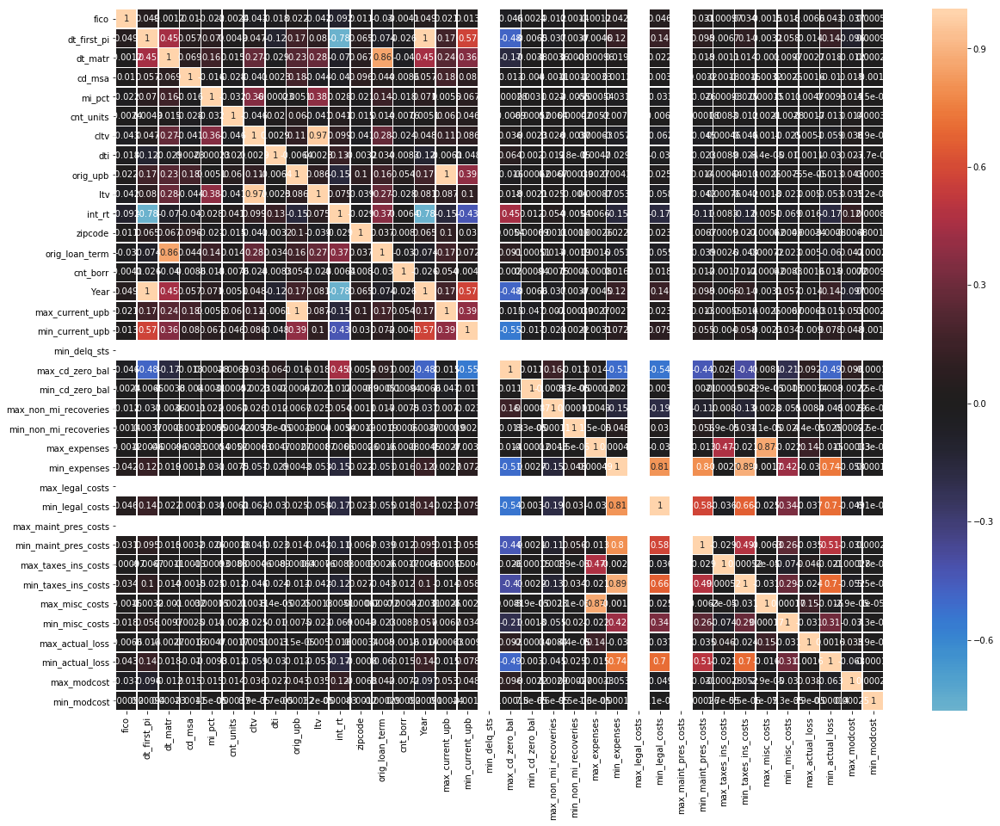

In [33]:
plt.figure(figsize=(20, 15))
sns.heatmap(joined_df.corr(), annot=True, linewidths=0.5, center=0)

Loan Term and date of maturity are correlated, there are many correlation in the later part which are inter related(expenses, actual loss,legal costs, maintaince costs, taxes and misc costs)

In [34]:
df_789['Quarter'] = df_789.loan_seq.apply(lambda x: x[4:6])

In [35]:
df_789['Quarter'] = df_789['Quarter'] + df_789['Year'].astype(str)

In [36]:
df_789['Quarter'].unique()

array(['Q12007', 'Q22007', 'Q32007', 'Q42007', 'Q12008', 'Q22008',
       'Q32008', 'Q42008', 'Q12009', 'Q22009', 'Q32009', 'Q42009'], dtype=object)

Checking the cltv and ltv features since they are highly correlated.

In [37]:
df_789[(df_789['cltv']-df_789['ltv']) == 0].count()

fico                     132634
dt_first_pi              132634
flag_fthb                132634
dt_matr                  132634
cd_msa                   132634
mi_pct                   132634
cnt_units                132634
occpy_sts                132634
cltv                     132634
dti                      132634
orig_upb                 132634
ltv                      132634
int_rt                   132634
channel                  132634
ppmt_pnlty               132634
prod_type                132634
st                       132634
prop_type                132634
zipcode                  132634
id_loan                  132634
loan_purpose             132634
orig_loan_term           132634
cnt_borr                 132634
seller_name              132634
servicer_name            132634
flag_sc                  132634
Year                     132634
loan_seq                 132634
max_current_upb          132634
min_current_upb          132634
max_delq_sts             132634
min_delq

In [38]:
df_789[(df_789['cltv']-df_789['ltv']) != 0].count()

fico                     17355
dt_first_pi              17355
flag_fthb                17355
dt_matr                  17355
cd_msa                   17355
mi_pct                   17355
cnt_units                17355
occpy_sts                17355
cltv                     17355
dti                      17355
orig_upb                 17355
ltv                      17355
int_rt                   17355
channel                  17355
ppmt_pnlty               17355
prod_type                17355
st                       17355
prop_type                17355
zipcode                  17355
id_loan                  17355
loan_purpose             17355
orig_loan_term           17355
cnt_borr                 17355
seller_name              17355
servicer_name            17355
flag_sc                  17355
Year                     17355
loan_seq                 17355
max_current_upb          17355
min_current_upb          17355
max_delq_sts             17355
min_delq_sts             17355
max_cd_z

We cannot ignore for now since there are 17355 values with few difference between them.

## Exploring the quarterly trends of features

**Quarterly Fico analysis**

In [39]:
df_789['fico'].groupby(df_789['Quarter']).mean()

Quarter
Q12007    730.921840
Q12008    736.084727
Q12009    762.793936
Q22007    729.270662
Q22008    745.362778
Q22009    766.450080
Q32007    726.151280
Q32008    745.153612
Q32009    760.025602
Q42007    727.503961
Q42008    758.871259
Q42009    760.073286
Name: fico, dtype: float64

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



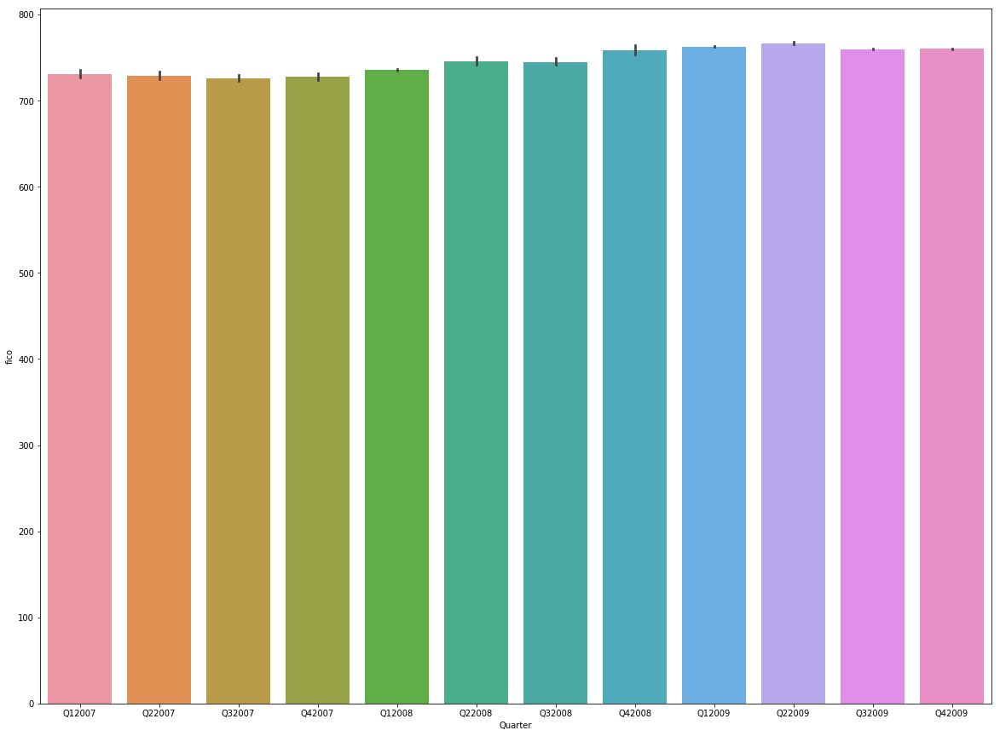

In [41]:
plt.figure(figsize=(20,15))
sns.barplot('Quarter','fico', data=df_789)

In [129]:
df_789.groupby(['Quarter']).mean()['fico'].iplot(
    yTitle='Credit Score',
    xTitle='Quarter',
    title='Quarter Wise Consumption Mean Credit Score',
    colors='Red',
    mode='lines+markers')

*From above plots, the mean credit score is evenly distributed across all the quarters with the highest mean credit score to be 766.45 for the Q22009. Alos we can see it is highest for the year 2009*

**Quarterly Interest Rate Analysis**

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



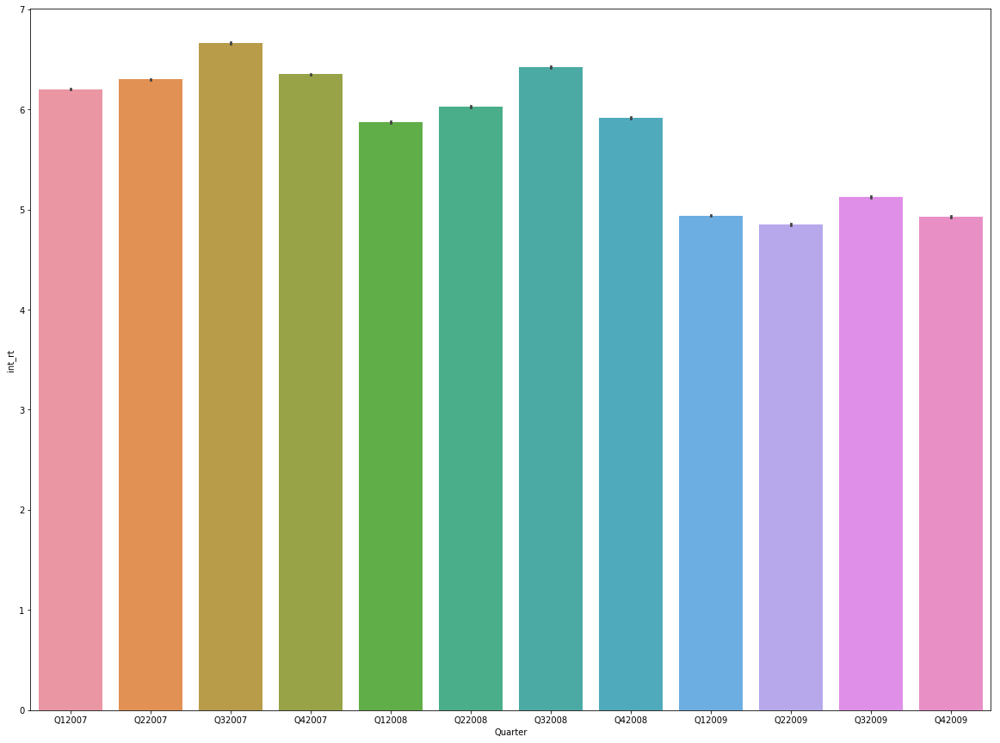

In [43]:
plt.figure(figsize=(20,15))
sns.barplot('Quarter','int_rt', data=df_789)

In [132]:
df_789.groupby(['Quarter']).mean()['int_rt'].iplot(
    yTitle='Interest Rate',
    xTitle='Quarter',
    title='Quarter Wise Mean Interest Rate',
    colors='Red',
    mode='lines+markers')

*The mean interest rate is lowest for the year 2009 and highest for the year 2007. It has decreased with time*

In [130]:
df_789.groupby(['Quarter']).max()['int_rt'].iplot(
    yTitle='Interest Rate',
    xTitle='Quarter',
    title='Quarter Wise Maximum Interest Rate',
    colors='Red',
    mode='lines+markers')

*Q3 in the year 2007 marked the highest interest rate*

**Quarterly UPB Analysis**

In [133]:
df_789.groupby(['Quarter']).mean()['orig_upb'].iplot(
    yTitle='Original UPB',
    xTitle='Quarter',
    title='Quarter Wise Mean Original UPB',
    colors='Red',
    mode='lines+markers')

*The mean org upb is lowest for the year 2007 and highest for the year 2009.The least to be in the 3rd quarter of 2007. It has increased with time.*

In [134]:
df_789.groupby(['Quarter']).mean()['max_current_upb'].iplot(
    yTitle='Max Current UPB',
    xTitle='Quarter',
    title='Quarter Wise Max Current UPB Mean',
    colors='Red',
    mode='lines+markers')

In [136]:
df_789.groupby(['Quarter']).mean()[['orig_upb','max_current_upb']].iplot(
    yTitle='Original UPB VS Max Current UPB',
    xTitle='Quarter',
    title='Quarter Wise Original UPB VS Max Current UPB',
    mode='lines+markers')

*The above two plots shows that the mean has been alomost the same for both original and max current upb.It increases over time.*

In [137]:
df_789.groupby(['Quarter']).mean()[['orig_upb','min_current_upb']].iplot(
    yTitle='Original UPB VS Min Current UPB',
    xTitle='Quarter',
    title='Quarter Wise Original UPB VS Min Current UPB',
    mode='lines+markers')

*Mim_current upb slightly increase over time*

In [139]:
df_789.groupby(['Quarter']).mean()[['max_current_upb','min_current_upb']].iplot(
    yTitle='Max Current UPB VS Min Current UPB',
    xTitle='Quarter',
    title='Quarter Wise Max Current UPB VS Min Current UPB',
    mode='lines+markers')

**Quarterly UPB vs Interest Rate Analysis**

In [141]:
df_789.groupby(['Quarter']).mean()[['orig_upb','int_rt']].iplot(
    yTitle='Original UPB VS Interest Rate',
    xTitle='Quarter',
    title='Quarter Wise Original UPB VS Interest Rate',
    mode='lines+markers')

*Interest rate decreases over time while ubp increases*

In [142]:
df_789.groupby(['Quarter']).mean()[['min_current_upb','int_rt']].iplot(
    yTitle='Min Current UPB VS Interest Rate',
    xTitle='Quarter',
    title='Quarter Wise Min Current UPB VS Interest Rate',
    mode='lines+markers')

*Minimum Current upb highly increase from 2008 to 2009 after Q1, may be because of crisis*

**Quartely Loan Analysis**

In [143]:
df_789.groupby(['Quarter']).count()['id_loan'].iplot(
   yTitle='Loan Count',
    xTitle='Quarter',
    title='Quarter Wise Total Loan',
    colors='Red',
    mode='lines+markers')

Least number of loans were taken in the quarter 4 of 2007 and the highest was in the first quarter of 2009

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:490: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



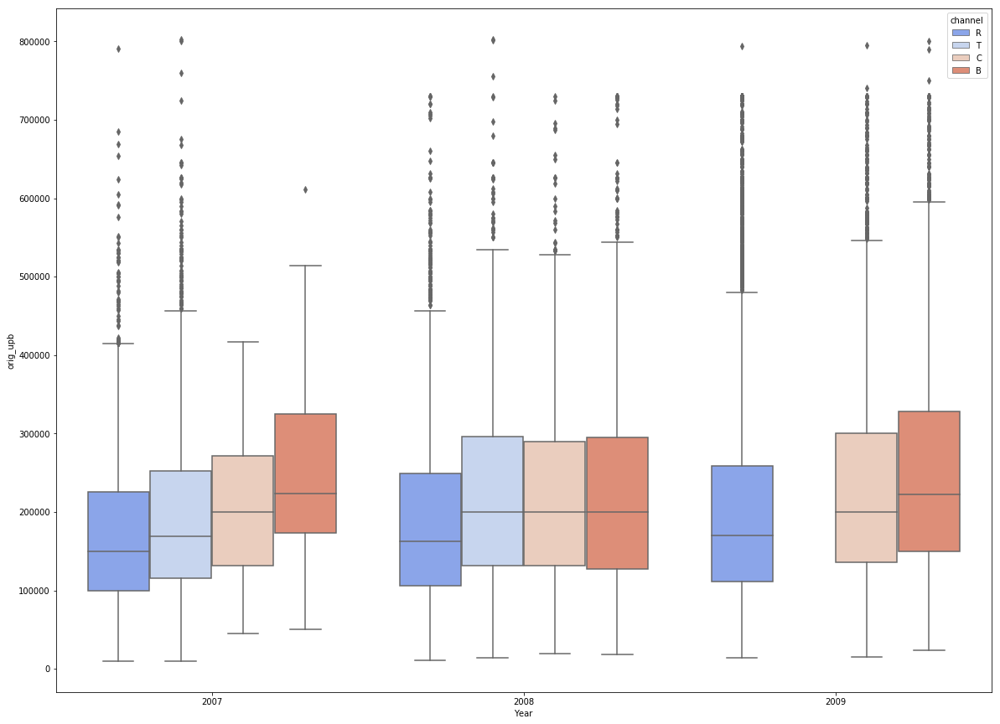

In [236]:
plt.figure(figsize=(20,15))
sns.boxplot(x="Year", y="orig_upb",hue="channel",data=df_789, palette="coolwarm")

In the 2nd quarter of 2009 'TPO was not specified' channel is not present.Borrowers channel contributed to most of upbs. 

In [191]:
df_789.groupby(['Quarter']).mean()[['cltv','ltv']].iplot(
    yTitle='Combined LTV VS LTV',
    xTitle='Year',
    title='Year Wise Combined Loan To Value VS Loan To Value Anaysis',
    mode='lines+markers')

As we have seen the mean ltv has been always less than combined ltv across the years in the above year wise analysis, it goes same for the quarter trends

In [192]:
df_789.groupby(['Quarter']).mean()[['cltv','ltv','dti']].iplot(
    yTitle='Combined LTV VS LTV',
    xTitle='Year',
    title='Year Wise Combined Loan To Value VS Loan To Value Anaysis',
    mode='lines+markers')

Mean DTI has decreased over the time from 2008 to 2009

**Different Variables Analysis**

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



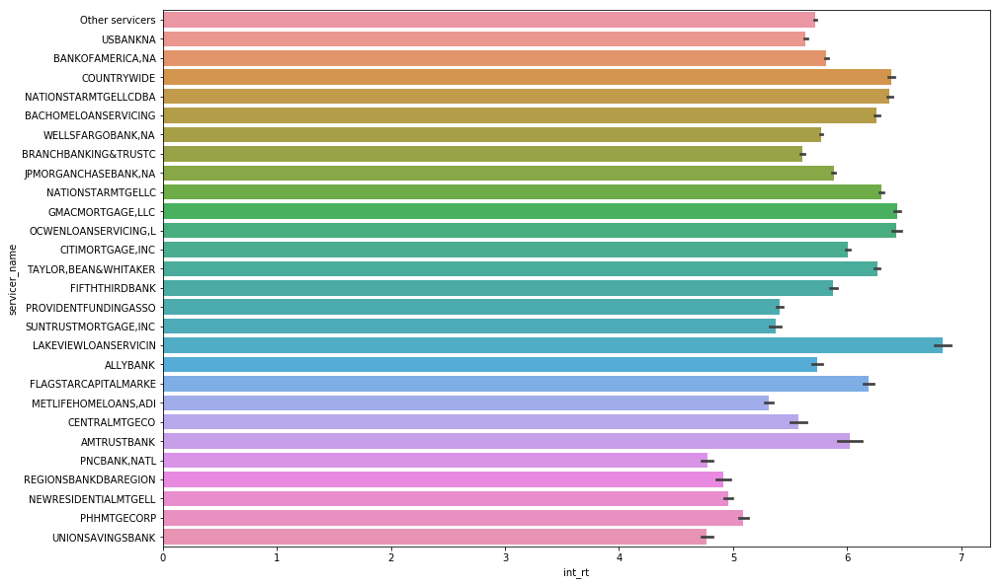

In [58]:
plt.figure(figsize=(15,10))
sns.barplot(x='int_rt', y='servicer_name',data= df_789)

Mean highest interest rate was for the service LAKEVIEWLOANSERVICEIN

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



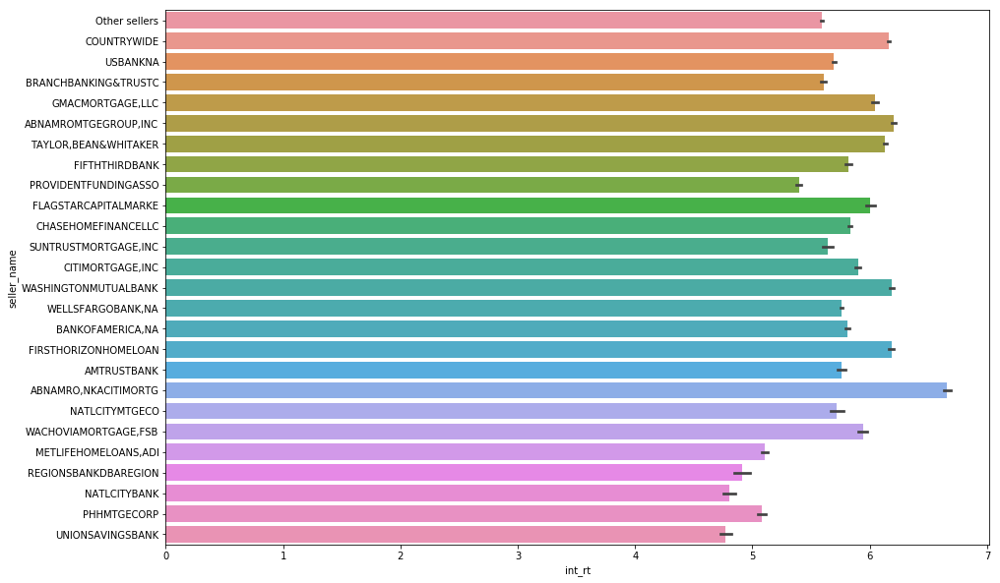

In [59]:
plt.figure(figsize=(15,10))
sns.barplot(x='int_rt', y='seller_name',data= df_789)

Mean highest interest rate was from the seller ABNAMRO

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



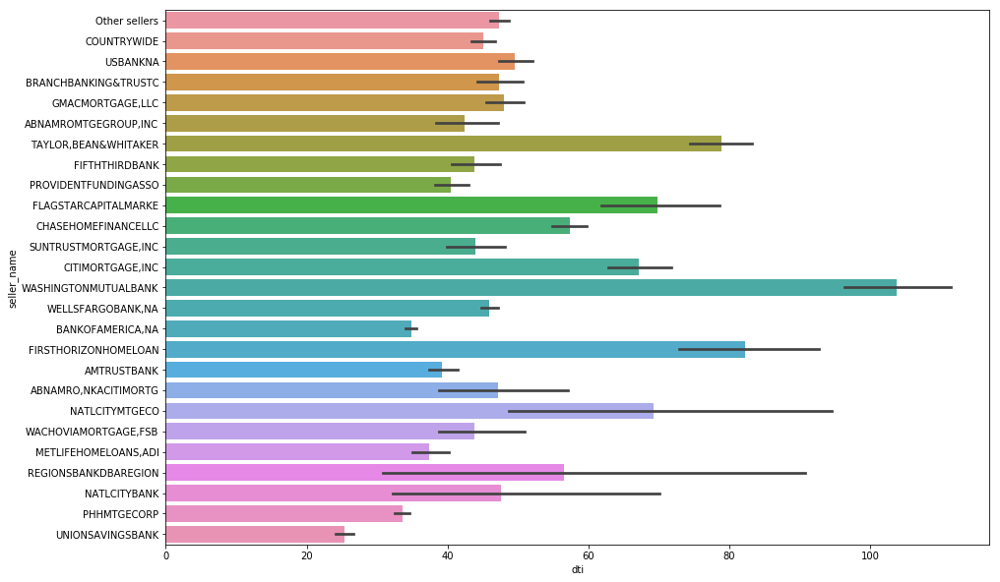

In [245]:
plt.figure(figsize=(15,10))
sns.barplot(x='dti', y='seller_name',data= df_789)

Seller WASHINGTON MUTUTAL BANK was involved with the loan with highest mean dti

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



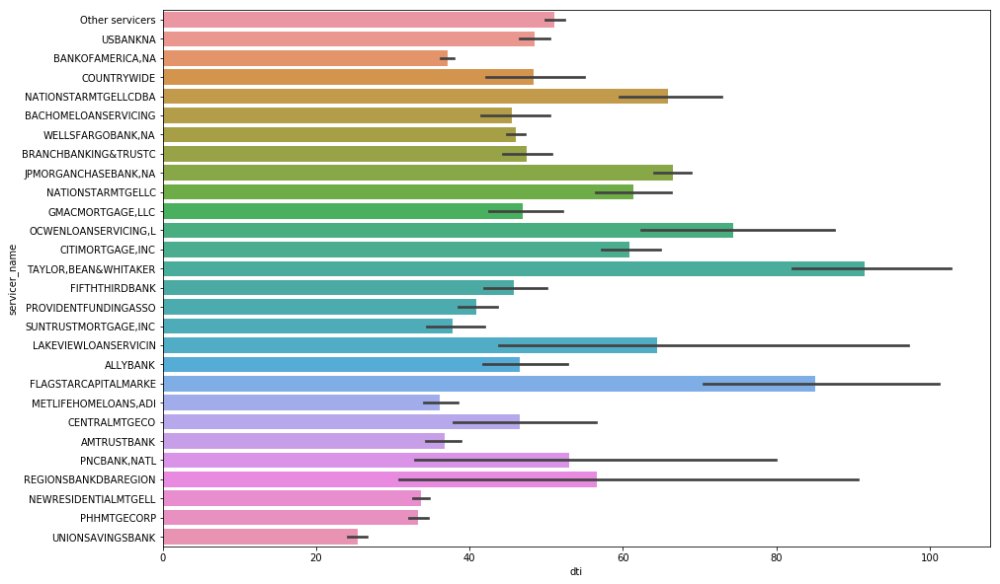

In [246]:
plt.figure(figsize=(15,10))
sns.barplot(x='dti', y='servicer_name',data= df_789)

Service TAYLOR,BEAN & WHITAKER was involved with the loan with highest mean dti

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:462: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



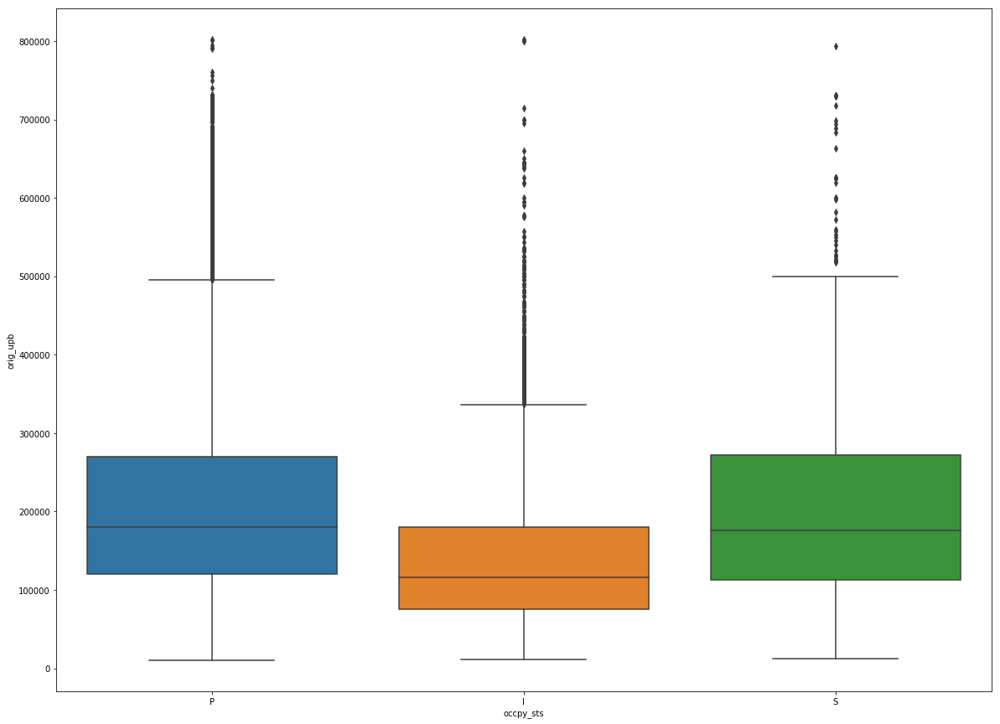

In [62]:
plt.figure(figsize=(20,15))
sns.boxplot('occpy_sts', 'orig_upb', data=df_789)

Most of loan involved in the occupancy status investement property had less average UBP values 

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



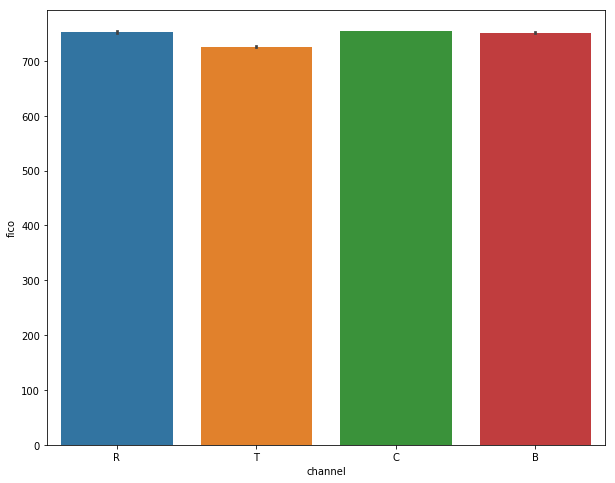

In [146]:
plt.figure(figsize=(10,8))
sns.barplot(x='channel', y='fico',data= df_789)

Mean Credit score was constant for the channels

**Delequency Status Analysis**

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



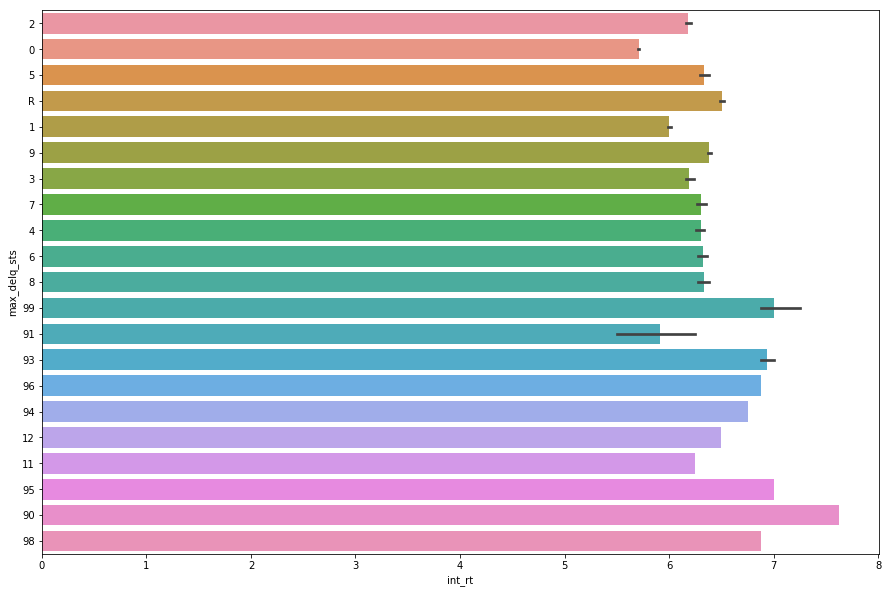

In [64]:
plt.figure(figsize=(15,10))
sns.barplot(x='int_rt', y='max_delq_sts',data= df_789)

highest mean interest rate was for the deliquency status 90

In [148]:
df_789.groupby(['Quarter']).count()['max_delq_sts'].iplot(
    yTitle='Maximum Deliquency Status',
    xTitle='Quarter',
    title='Quarter Wise Maximumm Deliquency Status Count',
    mode='lines+markers')

Least max deliquency count was for the Quarter 4 of 2007 and highest for Quarter 1 of 2009

In [157]:
df_789[df_789['max_delq_sts'] != 'R'].groupby(['Quarter']).max()[['max_delq_sts','max_taxes_ins_costs']].iplot(
    yTitle='Deliquency VS Taxes',
    xTitle='Quarter',
    title='Quarter Wise Deliquency VS Taxes',
    mode='lines+markers')

One exception for the quarter 3 of 2008 were the mean max_taxes_ins_costs was highest

**Spread Analysis of Numeric Features**

In [71]:
cols = list(df_789.columns)

for col in cols :
    if col not in ['min_actual_loss','max_actual_loss','min_misc_costs','max_misc_costs','max_taxes_ins_costs',
                   'min_taxes_ins_costs','max_maint_pres_costs','min_maint_pres_costs','max_legal_costs','max_legal_costs','max_expenses','min_expenses',
                   'max_non_mi_recoveries','min_non_mi_recoveries','min_delq_sts','min_cd_zero_bal','max_modcost','min_modcost']:
        df_789[col].iplot(kind='hist',xTitle=col,yTitle='Counts')

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


7005 is the highest Fico count  
Interest rate is evenly distributed across all the loans  
Count of units is 1 for most loans  
Ltv and Cltv is 79 for most of the loans  
Count of Mortgage Interest Percentage is close to zero for most of the loans    
Loan Term is in the range of 360-361 for most of the loans  
Max_cd_zero_bal is 1 for most of the loans  

**Numerical Features Analysis**

In [72]:
df_numerical= df_789.groupby('int_rt').mean()

In [73]:
df_numerical.iplot()

One can see, the mean of the features with respect to interest rate

**Interest Rate Analysis**

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:462: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



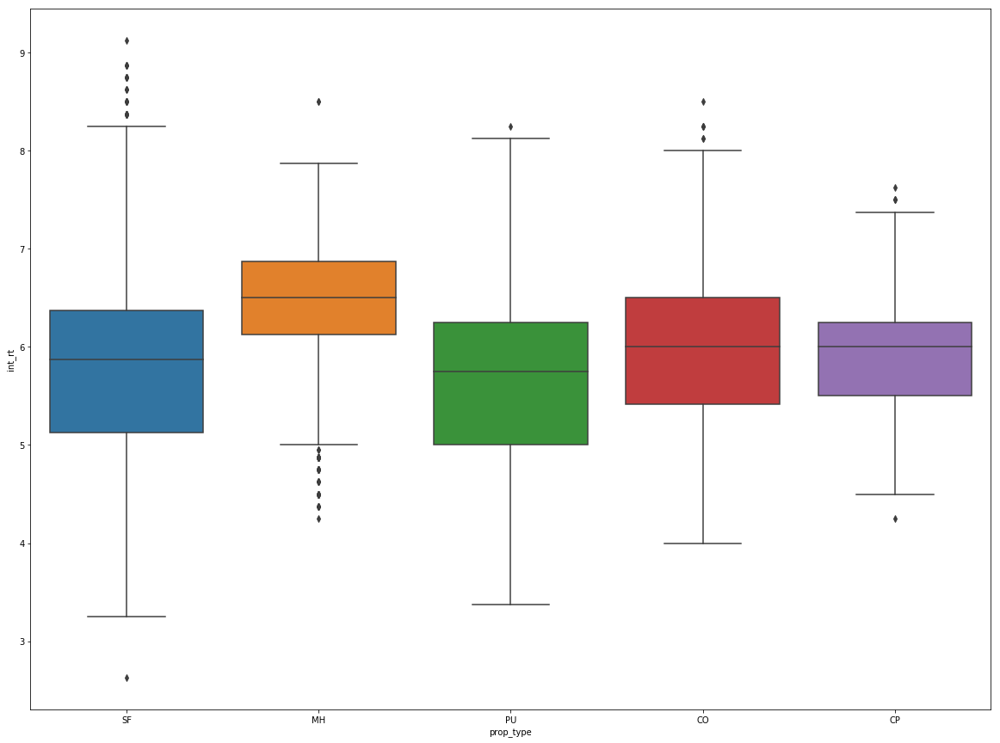

In [76]:
plt.figure(figsize=(20,15))
sns.boxplot('prop_type','int_rt', data=df_789)

Manufactured Housing types contributed the highest interest rates

In [247]:
df_789.groupby('prop_type').count()['id_loan'].iplot(
    yTitle='Loan Count',
    xTitle='Property Type',
    title='Property Type Wise Loan Count',
    colors='Red',
    mode='lines+markers')

SF types were related to the most of the loans

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



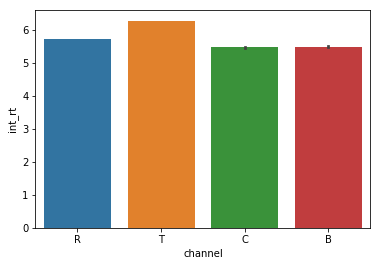

In [77]:
sns.barplot(x='channel', y='int_rt',data= df_789)

Interest Rate was high when TPO was Not Specified

In [249]:
ubp = df_789.groupby(['int_rt']).mean()[['orig_upb','min_current_upb']]
ubp.iplot(
    yTitle='Original UPB VS Min Current UPB',
    xTitle='Interest Rate',
    title='Interest Rate Wise Original UPB VS Min Current UPB',
    mode='lines')

Original UPB and Min Current UPB trends acccording to the mean interest rate

In [166]:
df_789.groupby('cnt_units').mean()['int_rt'].iplot(
    xTitle='cnt_units',
    yTitle='interest_rate',
    title='Units Wise Interest Rate Trends',
    colors='Red',
    mode='lines+markers')

Mean interest rate goes high with respect to count of units

In [250]:
df_789.groupby(['prop_type']).max()['int_rt'].iplot(
    yTitle='Interest Rate',
    xTitle='Prop Type',
    title='Prop Type Wise Max Interest Rate',
    colors='Red',
    mode='lines+markers')

CP has max interest rate of 7.625 while SF has max interest rate of 9.125

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



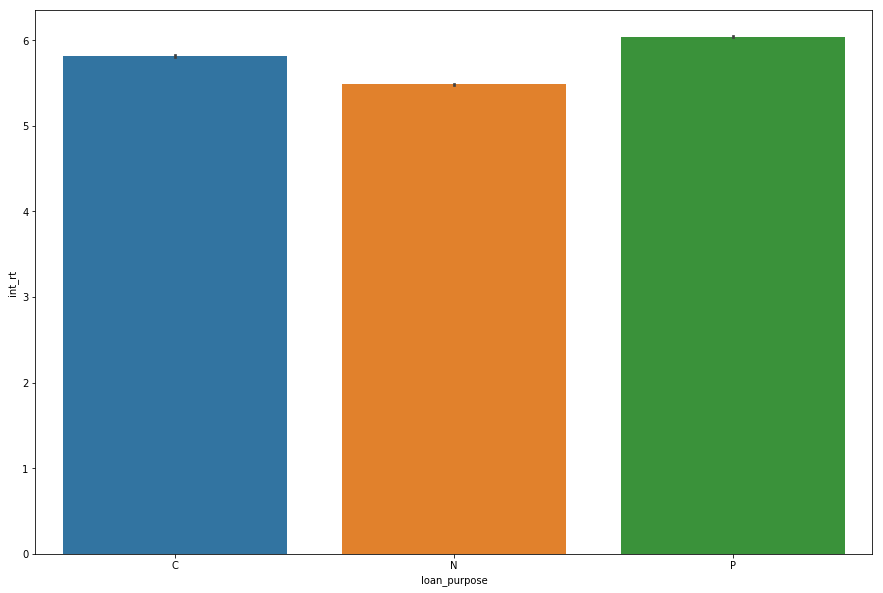

In [81]:
plt.figure(figsize=(15,10))
sns.barplot(x='loan_purpose', y='int_rt',data= df_789)

Mean Interest Rate was constant for all the loan purpose 

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:462: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



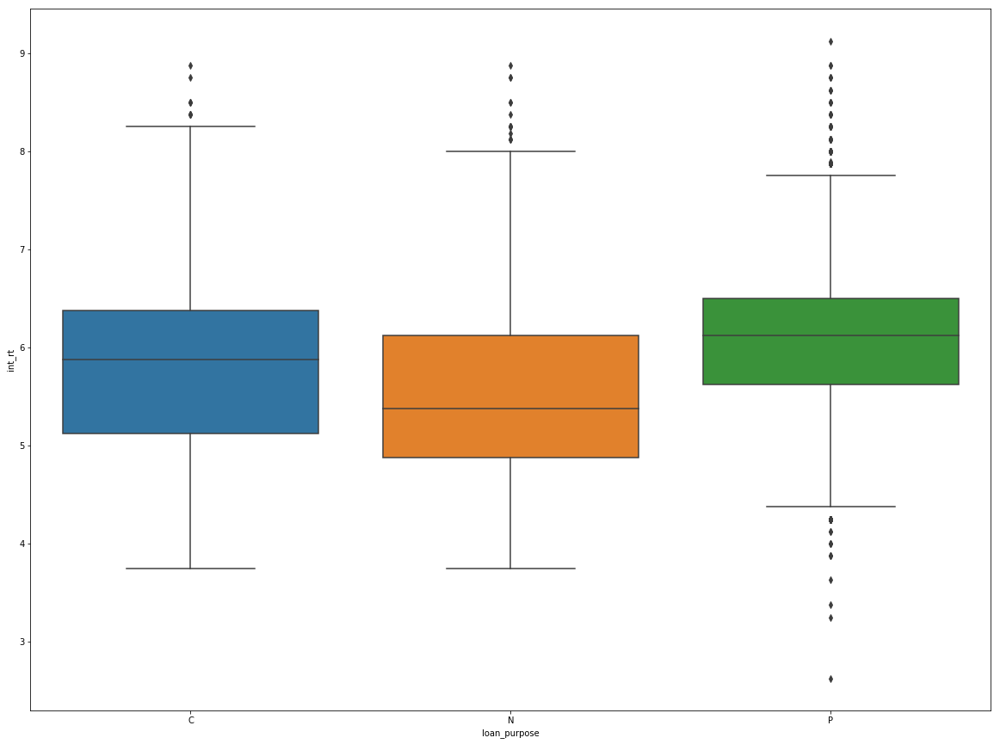

In [82]:
plt.figure(figsize=(20,15))
sns.boxplot('loan_purpose','int_rt', data=df_789)

Mean Interest Rate was constant for all the loan purpose 

In [171]:
df_789[df_789['loan_purpose'] != 9].groupby('loan_purpose').mean()['int_rt'].iplot(
    yTitle='Interest Rate',
    xTitle='Loan Purpose',
    title='Loan Purpose Wise Mean Interest',
    colors='Red',
    mode='lines+markers')

Mean Interest Rate was highest the Purchasing purpose 

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



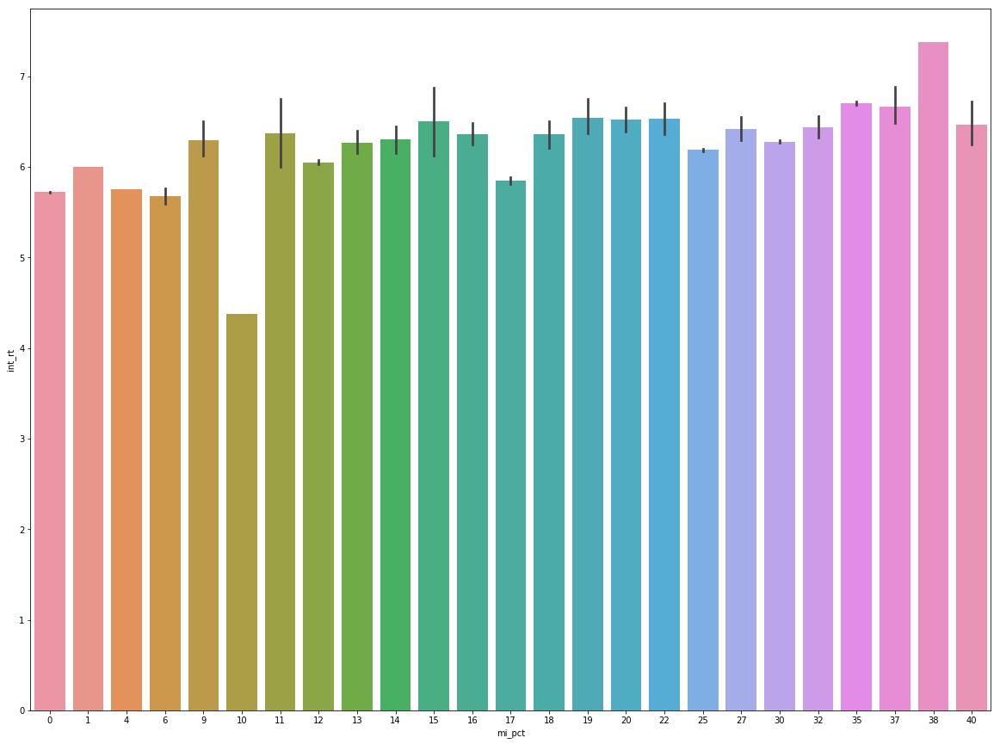

In [84]:
plt.figure(figsize=(20,15))
sns.barplot(x='mi_pct', y='int_rt',data= df_789)

High interest rate for 38 MI percentage

In [197]:
df_789[(df_789['mi_pct'] !=999) & (df_789['mi_pct'] != 0)].groupby('int_rt').mean()['mi_pct'].iplot(
    yTitle='MI Percentage',
    xTitle='Interest Rate ',
    title='Interest Rate Wise Mortgage Interest Percentage Mean',
    colors='Red',
    mode='lines+markers')

35 MI percentage noted a 9.125 interest rate

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:462: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



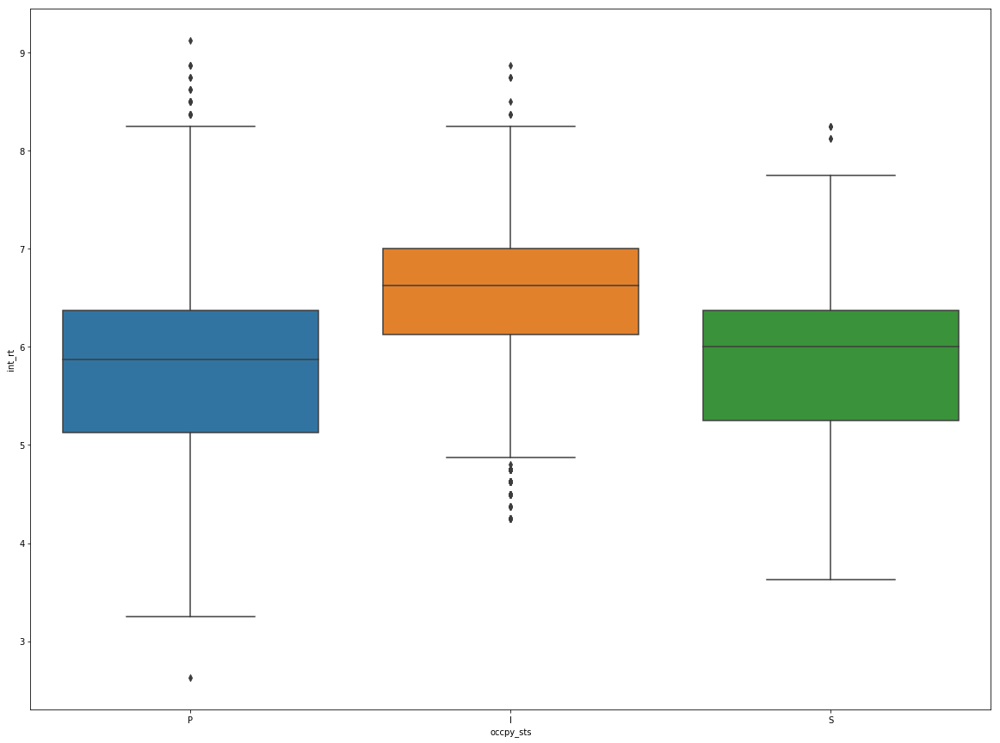

In [87]:
plt.figure(figsize=(20,15))
sns.boxplot('occpy_sts','int_rt', data=df_789)

 Investment Property occupancy status had high interest rate

**State Wise Analysis**

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



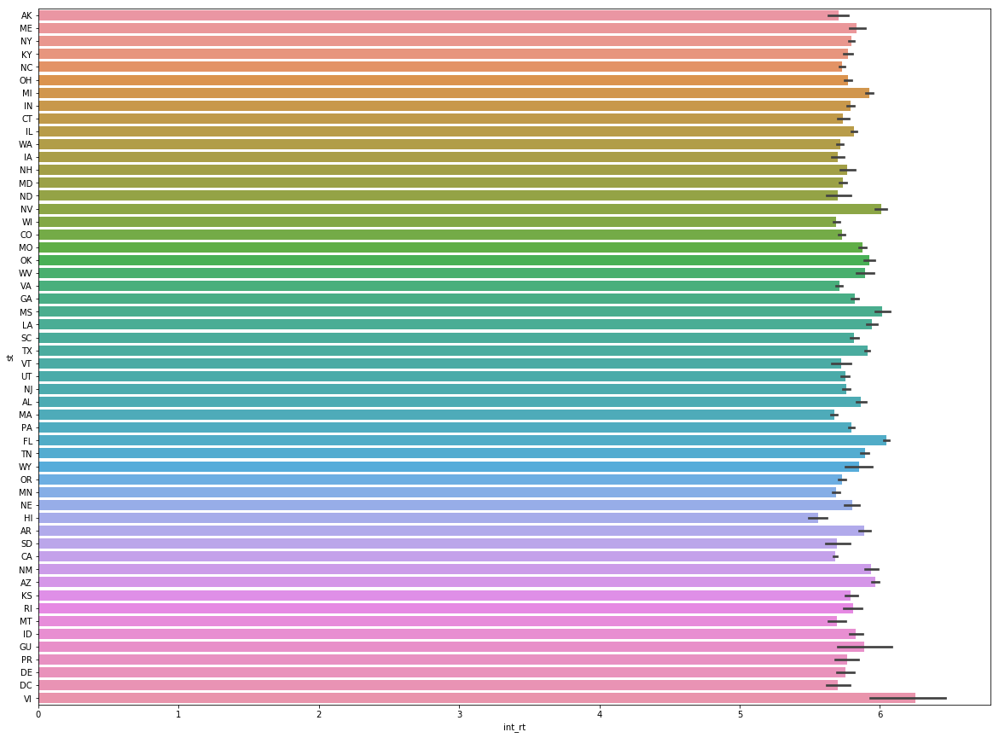

In [89]:
plt.figure(figsize=(20,15))
sns.barplot(x='int_rt', y='st',data= df_789)

VI has highest mean interest rate

In [174]:
df_789.groupby(['st'])['int_rt'].max().iplot(
    yTitle='Interest Rate',
    xTitle='State',
    title='State Wise Max Interest Rate',
    colors='Red',
    mode='lines+markers')

However, VI also had least maximum interest rate

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



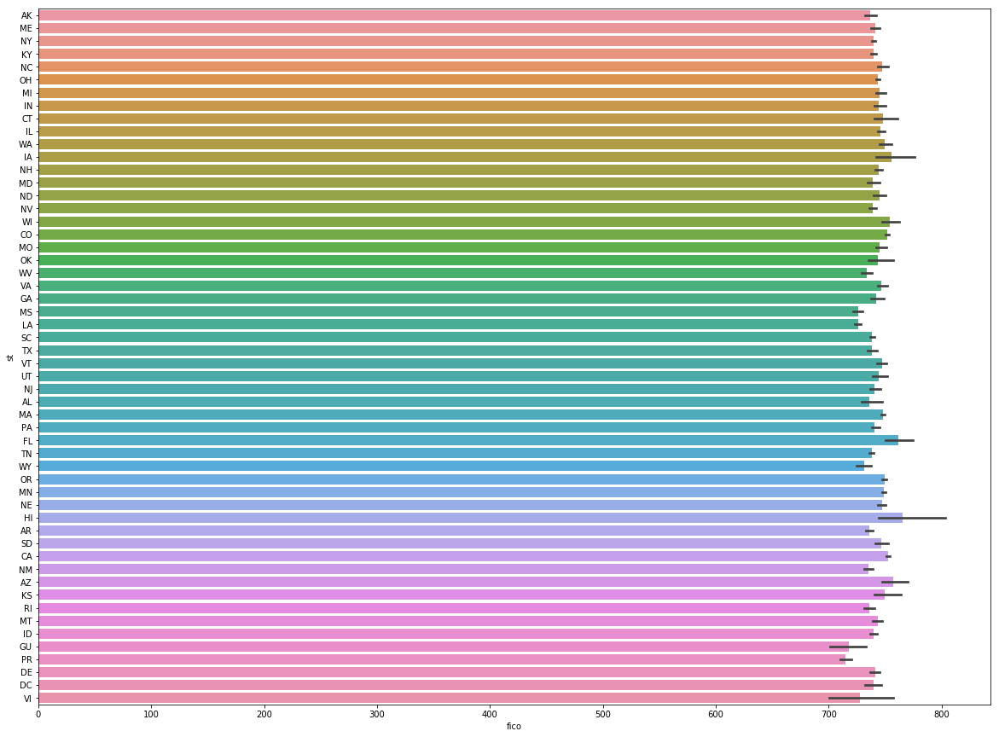

In [92]:
plt.figure(figsize=(20,15))
sns.barplot(x='fico', y='st',data= df_789)

HI has highest mean credit score

In [176]:
df_789[df_789['fico'] != 9999].groupby('st').mean()['fico'].iplot(
    yTitle='Credit Score',
    xTitle='State',
    title='State Wise Mean Credit Score',
    colors='Red',
    mode='lines+markers')

PR has least mean credit score of 715

In [175]:
df_789[df_789['fico'] != 9999].groupby('st').max()['fico'].iplot(
    yTitle='Credit Score',
    xTitle='State',
    title='State Wise Max Credit Score',
    colors='Red',
    mode='lines+markers')

VI has least maximum cedit score

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



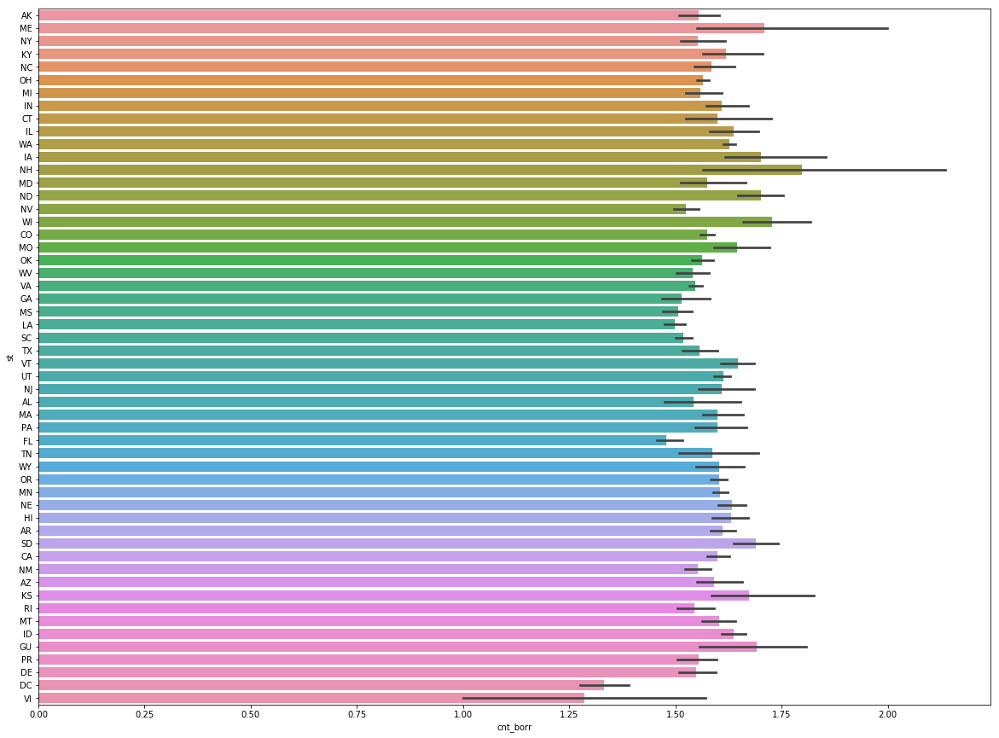

In [95]:
plt.figure(figsize=(20,15))
sns.barplot(x='cnt_borr', y='st',data= df_789)

Mean borrowers were highest from NH

In [254]:
df_789[df_789['cnt_borr'] != 99].groupby('st').count()['cnt_borr'].iplot(
    yTitle='Borrowers Count',
    xTitle='State',
    title='Month Wise Consumption in Appliances',
    colors='Red',
    mode='lines+markers')

Maximum borrowers were from CA

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



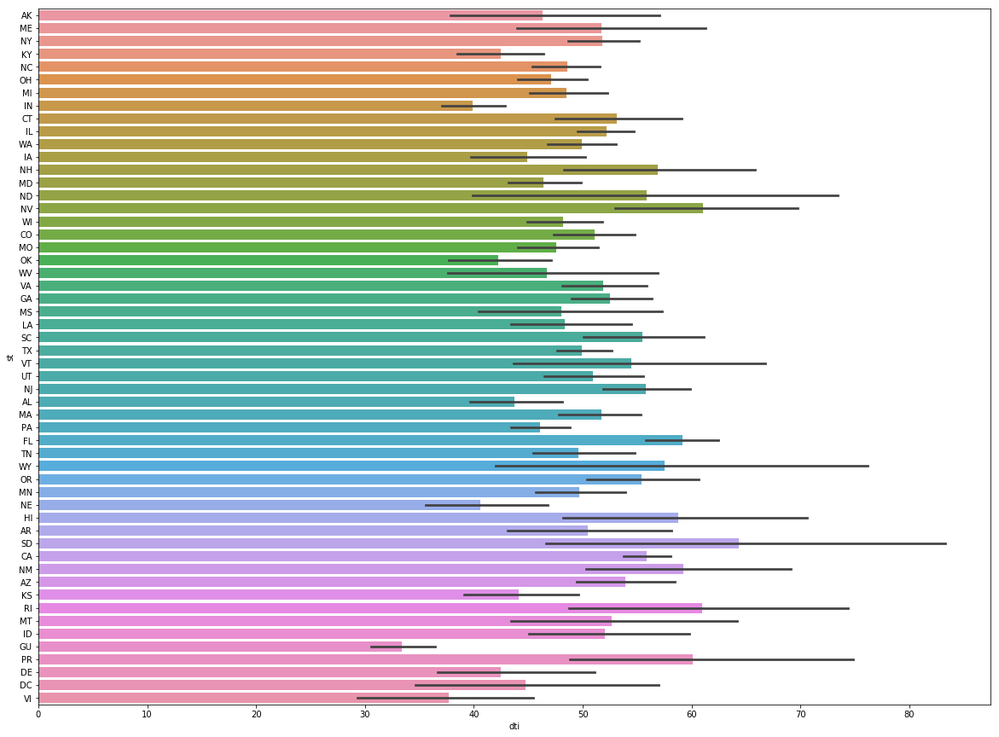

In [97]:
plt.figure(figsize=(20,15))
sns.barplot(x='dti', y='st',data= df_789)

Least Mean DTI was from GU

In [180]:
df_789[(df_789['dti'] != 999) & (df_789['dti'] < 65)].groupby('st').max()['dti'].iplot(
    yTitle='Debt To Income Ratio',
    xTitle='State',
    title='State Wise Max Debt To Income Ratio',
    colors='Red',
    mode='lines+markers')

Least max DTI was from VI

In [181]:
df_789[(df_789['dti'] != 999) & (df_789['dti'] < 65)].groupby('st').mean()['dti'].iplot(
    yTitle='Debt To Income Ratio',
    xTitle='State',
    title='State Wise Mean Debt To Income Ratio',
    colors='Red',
    mode='lines+markers')

C:\Users\Anuja\Anaconda3\lib\site-packages\seaborn\categorical.py:1460: FutureWarning:

remove_na is deprecated and is a private function. Do not use.



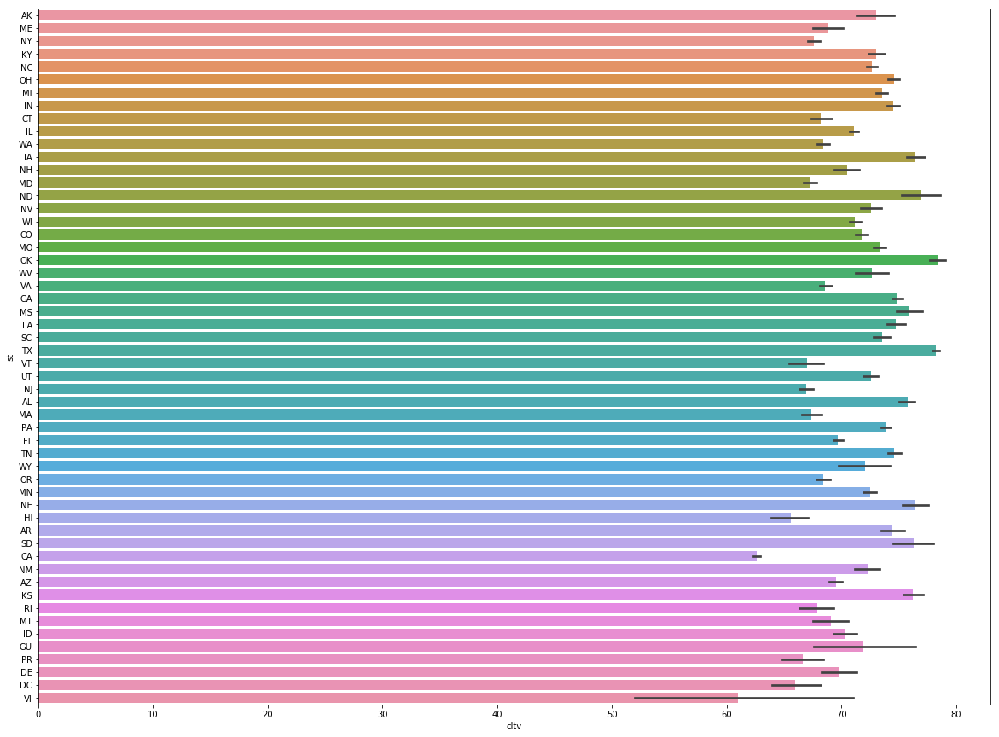

In [100]:
plt.figure(figsize=(20,15))
sns.barplot(x='cltv', y='st',data= df_789)

In [182]:
df_789[(df_789['cltv'] != 999)].groupby('st').mean()['cltv'].iplot(
    yTitle='Combined Loan To Value',
    xTitle='State',
    title='State Wise Mean Combined Loan To Value',
    colors='Red',
    mode='lines+markers')

Mean CLTV was least 61 from VI

In [183]:
df_789[(df_789['cltv'] != 999)].groupby('st').max()['cltv'].iplot(
    yTitle='Combined Loan To Value',
    xTitle='State',
    title='State Wise Mean Combined Loan To Value',
    colors='Red',
    mode='lines+markers')

In [186]:
df_789[(df_789['cltv'] != 999)].groupby('st').mean()[['ltv','cltv']].iplot(
    yTitle='Combined Loan To Value',
    xTitle='State',
    title='State Wise Mean Combined Loan To Value',
    mode='lines+markers')

In some states the cltv is greater than ltv and viceversa

### Checking the Credit Score values are correct according to the business rules

In [103]:
df_789[df_789['fico'] < 310]

,fico,dt_first_pi,flag_fthb,dt_matr,cd_msa,mi_pct,cnt_units,occpy_sts,cltv,dti,...,min_maint_pres_costs,max_taxes_ins_costs,min_taxes_ins_costs,max_misc_costs,min_misc_costs,max_actual_loss,min_actual_loss,max_modcost,min_modcost,Quarter


In [104]:
df_789[df_789['fico'] > 850].count()

fico                     59
dt_first_pi              59
flag_fthb                59
dt_matr                  59
cd_msa                   59
mi_pct                   59
cnt_units                59
occpy_sts                59
cltv                     59
dti                      59
orig_upb                 59
ltv                      59
int_rt                   59
channel                  59
ppmt_pnlty               59
prod_type                59
st                       59
prop_type                59
zipcode                  59
id_loan                  59
loan_purpose             59
orig_loan_term           59
cnt_borr                 59
seller_name              59
servicer_name            59
flag_sc                  59
Year                     59
loan_seq                 59
max_current_upb          59
min_current_upb          59
max_delq_sts             59
min_delq_sts             59
max_cd_zero_bal          59
min_cd_zero_bal          59
max_non_mi_recoveries    59
min_non_mi_recoverie

In [105]:
df_789[df_789['fico'] == 9999].count()

fico                     59
dt_first_pi              59
flag_fthb                59
dt_matr                  59
cd_msa                   59
mi_pct                   59
cnt_units                59
occpy_sts                59
cltv                     59
dti                      59
orig_upb                 59
ltv                      59
int_rt                   59
channel                  59
ppmt_pnlty               59
prod_type                59
st                       59
prop_type                59
zipcode                  59
id_loan                  59
loan_purpose             59
orig_loan_term           59
cnt_borr                 59
seller_name              59
servicer_name            59
flag_sc                  59
Year                     59
loan_seq                 59
max_current_upb          59
min_current_upb          59
max_delq_sts             59
min_delq_sts             59
max_cd_zero_bal          59
min_cd_zero_bal          59
max_non_mi_recoveries    59
min_non_mi_recoverie